# Test Planar Surface Code

In [3]:
import stim
import sinter
import planar_surface_code as psc
import numpy as np
from typing import List, Tuple
import pandas as pd
from itertools import product
import seaborn as sns
import copy
import matplotlib.pyplot as plt
import pymatching

In [4]:
def convert_to_per_round(total_LER: float, rounds: int) -> float:
    per_round_LER = 1/2 * (1 - np.abs(1-2*total_LER)**(1/rounds))
    return per_round_LER

In [3]:
d = 3
noise_profile = [0.01, 0.01, 0.01, 0.01]
my_planar_surf = psc.PlanarSurfaceCode(d)
info = my_planar_surf.get_info()
print("Numberf of ancilla qubits: ", len(info['ancilla_coords']), 
      ". Numberf of data qubits: ", len(info['data_coords']))   # list of ancilla qubit coordinates

Numberf of ancilla qubits:  12 . Numberf of data qubits:  13


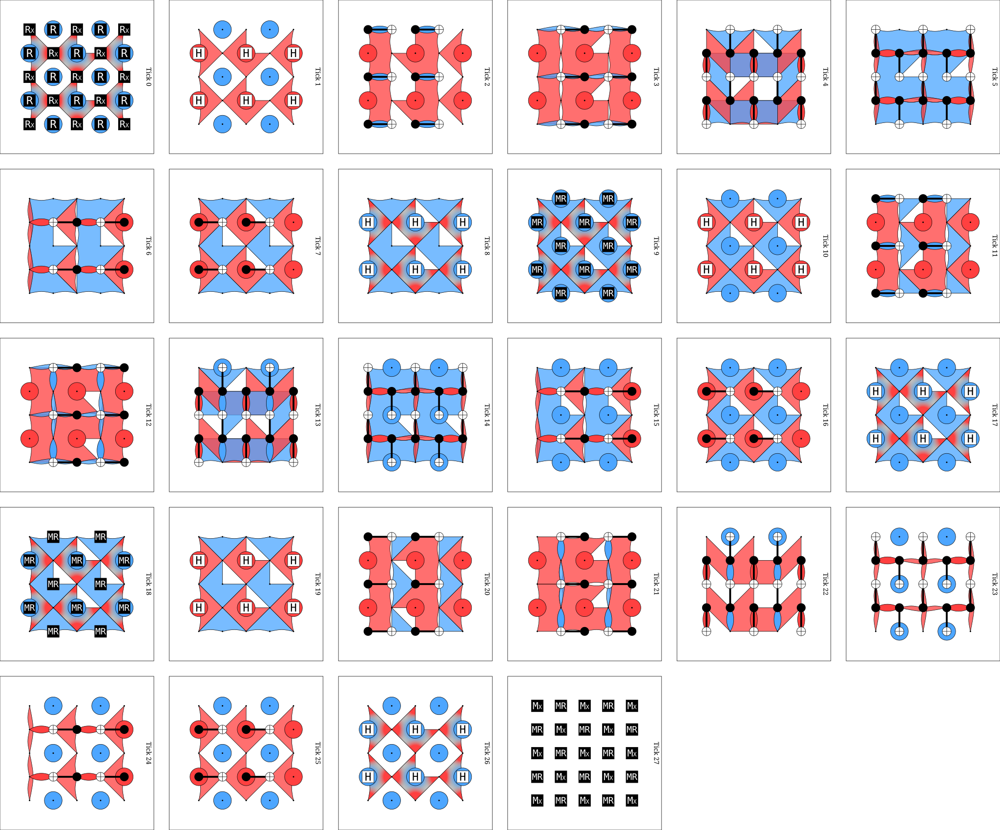

In [4]:
my_planar_circuit_x = my_planar_surf.build_full_surface_code_circuit(rounds=d, noise_profile=noise_profile, observable_type="X")
my_planar_circuit_x.without_noise().diagram("detslice-with-ops-svg")

In [5]:
tasks = []
d_list = [3, 5, 7]
p_list = [1e-3, 5e-3, 7e-3, 1e-2, 1.2e-2]  
for d in d_list:
    sf_code = psc.PlanarSurfaceCode(d)
    rounds = d
    for p in p_list:
        noise_profile = [p, p, p, p]
        sf_circuit = sf_code.build_full_surface_code_circuit(rounds=rounds, noise_profile = noise_profile, observable_type = "Z")
        tasks.append(sinter.Task(circuit=sf_circuit, json_metadata={'d': d, 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3]}))

collected_stats: List[sinter.TaskStats] = sinter.collect(
    num_workers=6,
    tasks=tasks,
    decoders=['pymatching'],
    max_shots=100,
    max_errors=100000, # Whichever first hits the threshold stops the simulation
)


In [7]:
records_sinter = []
for stat in collected_stats:
    d = stat.json_metadata['d']
    rounds = 2*d
    record = {
        'decoder': stat.decoder,
        'shots': stat.shots,
        'errors': stat.errors,
        'seconds': stat.seconds,
        'LER': convert_to_per_round(stat.errors / stat.shots, rounds) if stat.shots > 0 else None,
        'distance': d,
        'noise': stat.json_metadata['p1']
    }
    records_sinter.append(record)
df_sinter = pd.DataFrame(records_sinter)
# df.to_csv("results.csv", index=False) # If you wanna save the experiment data to csv

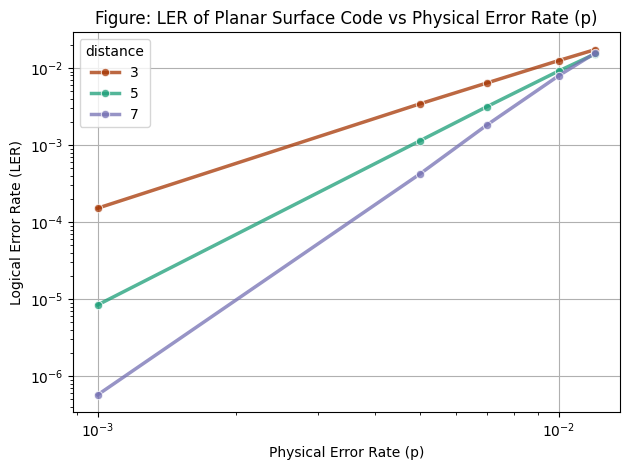

In [8]:
palette_distance = {
    3: "#a63603",   # dark orange-brown
    5: "#1b9e77",   # strong green
    7: "#7570b3",   # medium blue
    9:  "#d95f02",  # burnt orange
    11: "#e7298a",   # magenta
}

sns.lineplot(
    data=df_sinter[df_sinter.noise < 0.16],
    x="noise", y="LER",
    hue="distance",
    linewidth=2.5, alpha=0.75,
    palette=palette_distance, marker= 'o'
)

plt.xscale("log")
plt.yscale("log") # if you want a log-log plot
plt.title("Figure: LER of Planar Surface Code vs Physical Error Rate (p)")
plt.xlabel("Physical Error Rate (p)")
plt.ylabel("Logical Error Rate (LER)")
plt.grid(True)

plt.tight_layout()
plt.show()

### Lattice Surgery of Two Planar Surface Codes

In [9]:
def combine_two_patches(d1: int, d2: int) -> psc.MultiPatchSurfaceCode:
    '''d1 > d2'''
    coords_diff = [2 * d1, 0]
    sf_code1 = psc.PlanarSurfaceCode(d1)
    sf_code2 = psc.PlanarSurfaceCode(d2, shift=coords_diff)

    # Update logical Z of code 1 from left side to right side for merging
    sf_code1.logical_Z[0] = psc.PlanarSurfaceCode.shift_coords(sf_code1.logical_Z[0], (d1-1)*2, 0)

    # Combine two codes
    combined_codes = psc.MultiPatchSurfaceCode([sf_code1, sf_code2])

    return combined_codes

In [10]:
d1 = 5
d2 = 3
combined_codes = combine_two_patches(d1, d2)
noise_profile = [0.001] * 4
c1 = combined_codes.build_full_surface_code_circuit(rounds=d1, noise_profile=noise_profile, observable_type="Z")
c1.without_noise().diagram("detslice-with-ops-svg")

In [11]:
# Merge two surface codes

def merging_two_patches(combined_codes: psc.MultiPatchSurfaceCode) -> Tuple[psc.MultiPatchSurfaceCode, List[Tuple[int, int]]]:
    # Get the distance of the surface code
    d1 = combined_codes.code_list[0].d
    d2 = combined_codes.code_list[1].d

    # Merge two surface code patches
    merged_codes = copy.deepcopy(combined_codes)
    
    # Add boundary data
    boundary_data = [(2*d1-1, 2*y+1) for y in range(d1-1)]
    merged_codes.data_coords += boundary_data

    # Update stabilizers
    stabilizers = merged_codes.stabilizers
    # Update the boundary X-stabilizers from weight-3 to weight-4
    boundary_ancilla_x = [(2 * (d1-1), 2 * y + 1) for y in range(d1-1)] + [(2 * d1, 2 * y+1) for y in range(d2-1)]
    for stab in stabilizers:
        anc = stab['ancilla']
        if anc in boundary_ancilla_x:
            stab['data'] = [(anc[0], anc[1] + dy) for dy in [-1,1]] + [(anc[0] + dx, anc[1]) for dx in [-1,1]]
    # Append the boundary Z-gauges
    Z_gauges = []
    boundary_ancilla_z = [(2*d1-1, 2*y) for y in range(d1)]
    for y in range(d1):
        if y == 0:
            Z_gauges.append({'type': 'Z', 'ancilla': (2 * d1 - 1, 0), 'data': [(2 * d1 - 2, 0), (2 * d1, 0), (2 * d1 -1, 1)]})
        elif y <= d2 -2:
            Z_gauges.append({'type': 'Z', 'ancilla': (2*d1-1, 2*y), 'data': [(2*d1-1, 2*y + dy) for dy in [-1,1]] + [(2*d1-1 + dx, 2*y) for dx in [-1,1]]})
        elif y < d1 -1: # d2 - 2< y < d1 - 1
            Z_gauges.append({'type': 'Z', 'ancilla': (2*d1-1, 2*y), 'data': [(2*d1-1, 2*y + dy) for dy in [-1,1]] + [(2*d1-1 + dx, 2*y) for dx in [-1,1]]})
        else: # y == d1 - 1
            if d1 > d2:# bottom weight-2 gauge
                Z_gauges.append({'type': 'Z', 'ancilla': (2 * d1 -1, 2 * d1 - 2), 'data': [(2 * d1 -2, 2 * d1 -2), (2 * d1 -1, 2 * d1 -3)]})
            else: # d1 = d2
                Z_gauges.append({'type': 'Z', 'ancilla': (2 * d1 -1, 2 * d1 - 2), 'data': [(2 * d1 -2, 2 * d1 -2), (2 * d1 -1, 2 * d1 -3), (2 * d1, 2 * d1 -2)]})

    # Update merged code info
    stabilizers += Z_gauges
    merged_codes.stabilizers = stabilizers
    merged_codes.ancilla_coords_z += boundary_ancilla_z
    merged_codes.ancilla_coords += boundary_ancilla_z
    merged_codes.qubit_coords = merged_codes.data_coords + merged_codes.ancilla_coords

    boundary_qubits = boundary_data + boundary_ancilla_z
    current_coord_to_index = merged_codes.coord_to_index
    index_offset = max(current_coord_to_index.values()) + 1
    coord_to_index_boundary = {coord: i + index_offset for i, coord in enumerate(boundary_qubits)}
    merged_codes.coord_to_index.update(coord_to_index_boundary)
    merged_codes.index_to_coord = {i: coord for coord, i in merged_codes.coord_to_index.items()}

    merged_codes.logical_X = [merged_codes.logical_X[0] + merged_codes.logical_X[1]]
    merged_codes.logical_Z = [merged_codes.logical_Z[0]]

    return merged_codes, boundary_qubits

In [35]:
d1 = 5
d2 = 3
combined_codes = combine_two_patches(d1, d2)
merged_codes, boundary_qubits = merging_two_patches(combined_codes)
c2 = merged_codes.build_full_surface_code_circuit(rounds=d1, noise_profile=noise_profile, observable_type="Z")
c2.without_noise().diagram("detslice-with-ops-svg")

In [37]:
c2.diagram("matchgraph-3d")

{"accessors":[{"bufferView":0,"byteOffset":0,"componentType":5126,"count":9,"max":[0,0.400000005960464,0.400000005960464],"min":[0,-0.400000005960464,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":1,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0,0.400000005960464],"min":[-0.400000005960464,0,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":2,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0.400000005960464,0],"min":[-0.400000005960464,-0.400000005960464,0],"name":"circle_loop","type":"VEC3"},{"bufferView":3,"byteOffset":0,"componentType":5126,"count":9,"max":[0,0.400000005960464,0.400000005960464],"min":[0,-0.400000005960464,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":4,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0,0.400000005960464],"min":[-0.400000005960464,0,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":5,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0.400000005960464,0],"min":[-0.400000005960464,-0.400000005960464,0],"name":"circle_loop","type":"VEC3"},{"bufferView":6,"byteOffset":0,"componentType":5126,"count":21104,"max":[51.8748397827148,32.4799842834473,22.808687210083],"min":[-9.68400192260742,-6.3704252243042,-4.27606868743896],"name":"buf_scattered_lines","type":"VEC3"},{"bufferView":7,"byteOffset":0,"componentType":5126,"count":758,"max":[27,26,22.808687210083],"min":[21,0,0],"name":"buf_red_scattered_lines","type":"VEC3"}],"asset":{"version":"2.0"},"bufferViews":[{"buffer":0,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":1,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":2,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":3,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":4,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":5,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":6,"byteLength":253248,"byteOffset":0,"name":"buf_scattered_lines","target":34962},{"buffer":7,"byteLength":9096,"byteOffset":0,"name":"buf_red_scattered_lines","target":34962}],"buffers":[{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAM3MzD4AAAAAAAAAAMPQkD7D0JA+AAAAAPIwlrLNzMw+AAAAAMPQkL7D0JA+AAAAAM3MzL7yMBazAAAAAMHQkL7E0JC+AAAAAPLkozHNzMy+AAAAAMbQkD6/0JC+AAAAAM3MzD4AAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAAAAAADNzMw+w9CQPgAAAADD0JA+zczMPgAAAADyMJayw9CQPgAAAADD0JC+8jAWswAAAADNzMy+xNCQvgAAAADB0JC+zczMvgAAAADy5KMxv9CQvgAAAADG0JA+AAAAAAAAAADNzMw+"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,zczMPgAAAAAAAAAAw9CQPsPQkD4AAAAA8jCWss3MzD4AAAAAw9CQvsPQkD4AAAAAzczMvvIwFrMAAAAAwdCQvsTQkL4AAAAA8uSjMc3MzL4AAAAAxtCQPr/QkL4AAAAAzczMPgAAAAAAAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAM3MzD4AAAAAAAAAAMPQkD7D0JA+AAAAAPIwlrLNzMw+AAAAAMPQkL7D0JA+AAAAAM3MzL7yMBazAAAAAMHQkL7E0JC+AAAAAPLkozHNzMy+AAAAAMbQkD6/0JC+AAAAAM3MzD4AAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAAAAAADNzMw+w9CQPgAAAADD0JA+zczMPgAAAADyMJayw9CQPgAAAADD0JC+8jAWswAAAADNzMy+xNCQvgAAAADB0JC+zczMvgAAAADy5KMxv9CQvgAAAADG0JA+AAAAAAAAAADNzMw+"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,zczMPgAAAAAAAAAAw9CQPsPQkD4AAAAA8jCWss3MzD4AAAAAw9CQvsPQkD4AAAAAzczMvvIwFrMAAAAAwdCQvsTQkL4AAAAA8uSjMc3MzL4AAAAAxtCQPr/QkL4AAAAAzczMPgAAAAAAAAAA"},{"byteLength":253248,"name":"buf_scattered_lines","uri":"data:application/octet-stream;base64,AADYQQAAwEEAAAAAAADYQQAAkEEAAAAAAADYQQAAwEEAAAAAAADYQQAAwEEAAEBAAADYQQAAwEEAAAAAAADYQQAAkEEAAEBAAADYQQAAkEEAAAAAAADYQQAAQEEAAAAAAADYQQAAkEEAAAAAAADYQQAAkEEAAEBAAADYQQAAkEEAAAAAAADYQQAAQEEAAEBAAADYQQAAQEEAAAAAAADYQQAAwEAAAAAAAADYQQAAQEEAAAAAAAAEQgAA

In [12]:
tasks = []
noise_profile = [0.001] * 4
for d1, d2 in [(3,3), (5,3), (7,3)]:
    combined_codes = combine_two_patches(d1, d2)
    merged_codes, boundary_qubits = merging_two_patches(combined_codes)
    circuit_z = merged_codes.build_full_surface_code_circuit(rounds=d1, noise_profile=noise_profile, observable_type="Z")
    circuit_x = merged_codes.build_full_surface_code_circuit(rounds=d1, noise_profile=noise_profile, observable_type="X")
    tasks.append(sinter.Task(circuit=circuit_z, json_metadata={'d1': d1, 'd2': d2, 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3], 'Experiment': 'merged_z'}))
    tasks.append(sinter.Task(circuit=circuit_x, json_metadata={'d1': d1, 'd2': d2, 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3], 'Experiment': 'merged_x'}))

for d in [3, 5, 7]:
    sf = psc.PlanarSurfaceCode(d)
    rounds = d
    sf_circuit_z = sf.build_full_surface_code_circuit(rounds=rounds, noise_profile = noise_profile, observable_type = "Z")
    sf_circuit_x = sf.build_full_surface_code_circuit(rounds=rounds, noise_profile = noise_profile, observable_type = "X")
    tasks.append(sinter.Task(circuit=sf_circuit_z, json_metadata={'d1': d, 'd2': d, 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3], 'Experiment': 'single patch z'}))
    tasks.append(sinter.Task(circuit=sf_circuit_x, json_metadata={'d1': d, 'd2': d, 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3], 'Experiment': 'single patch x'}))
    
collected_stats: List[sinter.TaskStats] = sinter.collect(
    num_workers=6,
    tasks=tasks,
    decoders=['pymatching'],
    max_shots=10000000, # change to large number for full scale experiment
    max_errors=100000, # Whichever first hits the threshold stops the simulation
    print_progress=True,
)
# Convert collected_stats into Dataframe
records = []
for stat in collected_stats:
    d1 = stat.json_metadata['d1']
    d2 = stat.json_metadata['d2']
    rounds = d
    record = {
        'decoder': stat.decoder,
        'shots': stat.shots,
        'errors': stat.errors,
        'seconds': stat.seconds,
        'LER': convert_to_per_round(stat.errors / stat.shots, rounds) if stat.shots > 0 else None,
        'Experiment': stat.json_metadata['Experiment'],
        'd1': d1,
        'd2': d2,
        'p1': stat.json_metadata['p1'], 'p2': stat.json_metadata['p2'], 'pM': stat.json_metadata['pM'], 'pR': stat.json_metadata['pR']
    }
    records.append(record)
df_sf = pd.DataFrame(records)
df_sf
# df_sf.to_csv("results.csv", index=False) # If you wanna save the experiment data to csv

KeyboardInterrupt: 

(1) For Z memory experiment, the merged patch gives a lower LER than a single patch given the same **d1**. This is due to the longer logical X operators on the merged patch (so they are more difficult to form);  In short, for Z memory experiment, the merged patch has better performance than it's larger-distance component;
(2) For X memory experiment, the merged patch gives a higher LER than a single patch given the same **d2**. This is because it adds more possibility of logical Z errors from the d1-distance component. In short, for X memory experiment, the merged patch has worse performance than it's smaller-distance component. We can see that as d1 increases, the LER stays at the level of 1e-4 and cannot be sufficiently suppressed. That means a smaller distance somewhere in the code can significantly bottleneck the QEC performance of the code.

### Logical ZZ measurement  
We perform logical ZZ measurement on two logical $|0\rangle$ state, so the Z gauge operators always multiply to $+1$ if there's no noise. That will be our logical observable.

In [14]:
# Logical ZZ measurement, possibly with different distances
def logical_ZZ_measurement(d1: int, d2: int, rounds: int, noise_profile: List[float], combined_codes: psc.MultiPatchSurfaceCode, merged_codes: psc.MultiPatchSurfaceCode) -> stim.Circuit:
    '''d1 > d2: dstance of two surface codes for merging
    rounds: number of SM rounds after XX measurement
    noise_profile: [p1, p2, p_M, p_R]
   '''

    p1, p2, p_M, p_R = noise_profile
    full_circuit = stim.Circuit()

    # (1) Construct two perfect surface codes using one round of SM without noise
    # Add QUBIT_COORDS annotations
    for (x, y), index in merged_codes.coord_to_index.items():
        full_circuit.append('QUBIT_COORDS', [index], [x, y])

    # Initialization of qubits in two patches (no boundary qubits yet)
    data_indices = [combined_codes.coord_to_index[c] for c in combined_codes.data_coords]
    ancilla_indices = [combined_codes.coord_to_index[c] for c in combined_codes.ancilla_coords]
    full_circuit.append_operation("R", data_indices)
    full_circuit.append_operation("R", ancilla_indices)
    full_circuit.append("TICK")

    # One round of SM without noise, gives two perfect surface codes
    # At this point we have two surface codes with +1 Z-stabilziers and random value X-stabilizers
    full_circuit += combined_codes.build_standard_sm_round(noise_profile)
    # Detectors
    for k, ancilla in enumerate(reversed(combined_codes.ancilla_coords)):
        if ancilla in combined_codes.ancilla_coords_z:
            full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1)], list(ancilla) + [0])

    full_circuit = full_circuit.without_noise()

    # (2) Noisy ZZ measurement
    # Initialize the boundary qubits
    boundary_data = [(2*d1-1, 2*y+1) for y in range(d1-1)]
    boundary_ancilla_z = [(2*d1-1, 2*y) for y in range(d1)]
    boundary_data_indices = [merged_codes.coord_to_index[coord] for coord in boundary_data]
    boundary_ancilla_z_indices = [merged_codes.coord_to_index[c] for c in boundary_ancilla_z]

    full_circuit.append_operation("RX", boundary_data_indices)
    full_circuit.append_operation("Z_ERROR", boundary_data_indices, p_R)
    full_circuit.append_operation("R", boundary_ancilla_z_indices)
    full_circuit.append_operation("X_ERROR", boundary_ancilla_z_indices, p_R)
    full_circuit.append("TICK")

    # First round measurement, gauge fixing
    full_circuit += merged_codes.build_standard_sm_round(noise_profile=noise_profile)
    full_circuit.append("TICK")
    # Detectors
    full_circuit.append_operation("SHIFT_COORDS", [], [0,0,1])
    for k, ancilla in enumerate(reversed(merged_codes.ancilla_coords)):
        if ancilla not in boundary_ancilla_z:
            prev = -k - 1-len(combined_codes.ancilla_coords)
            full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1), stim.target_rec(prev)], list(ancilla) + [0])

    # Repeated rounds
    repeat_circuit = stim.Circuit()
    repeat_circuit.append("TICK")
    repeat_circuit += merged_codes.build_standard_sm_round(noise_profile)
    repeat_circuit.append_operation("SHIFT_COORDS", [], [0,0,1])
    # Insert detectors
    for k, ancilla in enumerate(reversed(merged_codes.ancilla_coords)):
        # ancilla_index = self.coord_to_index[ancilla]
        prev = -k - 1 - len(merged_codes.ancilla_coords)
        repeat_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1), stim.target_rec(prev)], list(ancilla) + [0])

    full_circuit += repeat_circuit * (rounds-1)

    # Final measurement
    final_data_indices = [merged_codes.coord_to_index[q] for q in merged_codes.data_coords]
    full_circuit.append_operation("X_ERROR", final_data_indices, p_M)
    full_circuit.append_operation("M", final_data_indices)

    # Final detectors
    for stab in combined_codes.stabilizers:
        if stab['type'] == "Z":
            anc = stab['ancilla']
            try:
                ancilla_index = merged_codes.ancilla_coords[::-1].index(anc)
                anc_rec = stim.target_rec(-ancilla_index - 1 - len(merged_codes.data_coords))
                data_rec_targets = [stim.target_rec(-merged_codes.data_coords[::-1].index(q) - 1) for q in stab['data']]
                full_circuit.append_operation("DETECTOR", [anc_rec] + data_rec_targets, list(anc) + [1])
            except ValueError:
                continue

    # Logical observale: Z gauge operators (enough for |00> initial state); Z gauge operators + boundary data qubits (if other initializations)
    log_ob_gauge = [(2*d1-1,2*y) for y in range(d1)]
    log_ob_gauge_indices = [merged_codes.ancilla_coords[::-1].index(anc) for anc in log_ob_gauge]
    log_ob_gauge_records = [stim.target_rec(-k-1-len(merged_codes.data_coords)) for k in log_ob_gauge_indices]
    log_ob_data = [(2*d1-2,2*y) for y in range(d1)] + [(2*d1,2*y) for y in range(d2)]
    log_ob_data_indices = [merged_codes.data_coords[::-1].index(data) for data in log_ob_data]
    log_ob_data_records = [stim.target_rec(-k-1) for k in log_ob_data_indices]
    full_circuit.append_operation("OBSERVABLE_INCLUDE", log_ob_gauge_records, 0) 
    # log_ob_gauge_records + log_ob_data_records also works! We've verified that they give similar LER

    return full_circuit

In [15]:
d1 = 5
d2 = 3
rounds = d1
noise_profile = [0.001] * 4
combined_codes = combine_two_patches(d1, d2)
merged_codes, boundary_qubits = merging_two_patches(combined_codes)
circuit_ZZ_meas = logical_ZZ_measurement(d1, d2, rounds, noise_profile, combined_codes, merged_codes)
circuit_ZZ_meas.without_noise().diagram('detslice-with-ops-svg')

In [16]:
circuit_ZZ_meas.diagram("matchgraph-3d")

{"accessors":[{"bufferView":0,"byteOffset":0,"componentType":5126,"count":9,"max":[0,0.400000005960464,0.400000005960464],"min":[0,-0.400000005960464,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":1,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0,0.400000005960464],"min":[-0.400000005960464,0,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":2,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0.400000005960464,0],"min":[-0.400000005960464,-0.400000005960464,0],"name":"circle_loop","type":"VEC3"},{"bufferView":3,"byteOffset":0,"componentType":5126,"count":9,"max":[0,0.400000005960464,0.400000005960464],"min":[0,-0.400000005960464,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":4,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0,0.400000005960464],"min":[-0.400000005960464,0,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":5,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0.400000005960464,0],"min":[-0.400000005960464,-0.400000005960464,0],"name":"circle_loop","type":"VEC3"},{"bufferView":6,"byteOffset":0,"componentType":5126,"count":23704,"max":[51.8994941711426,32.9442710876465,28],"min":[-9.52579307556152,-8.9442720413208,-5.16496562957764],"name":"buf_scattered_lines","type":"VEC3"},{"bufferView":7,"byteOffset":0,"componentType":5126,"count":1288,"max":[42.7014236450195,32.9442710876465,22.0710678100586],"min":[21,-8.9442720413208,-7],"name":"buf_red_scattered_lines","type":"VEC3"}],"asset":{"version":"2.0"},"bufferViews":[{"buffer":0,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":1,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":2,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":3,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":4,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":5,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":6,"byteLength":284448,"byteOffset":0,"name":"buf_scattered_lines","target":34962},{"buffer":7,"byteLength":15456,"byteOffset":0,"name":"buf_red_scattered_lines","target":34962}],"buffers":[{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAM3MzD4AAAAAAAAAAMPQkD7D0JA+AAAAAPIwlrLNzMw+AAAAAMPQkL7D0JA+AAAAAM3MzL7yMBazAAAAAMHQkL7E0JC+AAAAAPLkozHNzMy+AAAAAMbQkD6/0JC+AAAAAM3MzD4AAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAAAAAADNzMw+w9CQPgAAAADD0JA+zczMPgAAAADyMJayw9CQPgAAAADD0JC+8jAWswAAAADNzMy+xNCQvgAAAADB0JC+zczMvgAAAADy5KMxv9CQvgAAAADG0JA+AAAAAAAAAADNzMw+"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,zczMPgAAAAAAAAAAw9CQPsPQkD4AAAAA8jCWss3MzD4AAAAAw9CQvsPQkD4AAAAAzczMvvIwFrMAAAAAwdCQvsTQkL4AAAAA8uSjMc3MzL4AAAAAxtCQPr/QkL4AAAAAzczMPgAAAAAAAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAM3MzD4AAAAAAAAAAMPQkD7D0JA+AAAAAPIwlrLNzMw+AAAAAMPQkL7D0JA+AAAAAM3MzL7yMBazAAAAAMHQkL7E0JC+AAAAAPLkozHNzMy+AAAAAMbQkD6/0JC+AAAAAM3MzD4AAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAAAAAADNzMw+w9CQPgAAAADD0JA+zczMPgAAAADyMJayw9CQPgAAAADD0JC+8jAWswAAAADNzMy+xNCQvgAAAADB0JC+zczMvgAAAADy5KMxv9CQvgAAAADG0JA+AAAAAAAAAADNzMw+"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,zczMPgAAAAAAAAAAw9CQPsPQkD4AAAAA8jCWss3MzD4AAAAAw9CQvsPQkD4AAAAAzczMvvIwFrMAAAAAwdCQvsTQkL4AAAAA8uSjMc3MzL4AAAAAxtCQPr/QkL4AAAAAzczMPgAAAAAAAAAA"},{"byteLength":284448,"name":"buf_scattered_lines","uri":"data:application/octet-stream;base64,AAAcQgAAQEEAAEBAhPJBQgAAQEEgLCa+AAAcQgAAQEEAAEBAAAAEQgAAQEEAAEBAAAAcQgAAQEEAAEBAAAAEQgAAQEEAAEBAAAAQQgAAEEEAAEBAzIM0QoaT5UCgxya/AAAcQgAAQEEAAEBAAAAcQgAAwEAAAEBAAAAcQgAAQEEAAEBAAAAcQgAAwEAAAEBAAAAoQgAAEEEAAEBAAAAQQg

In [ ]:
num_samples = 1000000 
s_ZZ_meas = circuit_ZZ_meas.compile_detector_sampler().sample(num_samples, append_observables=True)

# LER without decoding
LER_no_decode = np.sum(s_ZZ_meas[:, -1])/num_samples
print("LER without decoding: ", LER_no_decode)

detection_events = s_ZZ_meas[:,:-1]
observable_flips = s_ZZ_meas[:,-1:]

# Configure a decoder using the circuit.
detector_error_model = circuit_ZZ_meas.detector_error_model(decompose_errors=True)
matcher = pymatching.Matching.from_detector_error_model(detector_error_model)

# Run the decoder.
predictions = matcher.decode_batch(detection_events)

# Count the mistakes.
num_errors = np.sum(np.any(predictions != observable_flips, axis=1)) # this works for codes with multiple logical operators
LER_decode = convert_to_per_round(num_errors/ num_samples)
print("LER with decoding: ", LER_decode)

LER without decoding:  0.022929
LER with decoding:  0.00099


In [17]:
tasks = []
noise_profile = [0.001] * 4
# for d1, d2 in [(3, 3), (5, 3), (5, 5), (7, 3), (7, 5), (7, 7)]:
for d1, d2 in [(5,5)]:
    rounds = 3*d1
    combined_codes = combine_two_patches(d1, d2)
    merged_codes, boundary_qubits = merging_two_patches(combined_codes)
    circuit_ZZ_meas = logical_ZZ_measurement(d1, d2, rounds, noise_profile, combined_codes, merged_codes)
    tasks.append(sinter.Task(circuit=circuit_ZZ_meas, json_metadata={'d1': d1, 'd2': d2, 'rounds': rounds, 'Experiment': 'ZZ Measurement', 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3]}))


collected_stats: List[sinter.TaskStats] = sinter.collect(
    num_workers=6,
    tasks=tasks,
    decoders=['pymatching'],
    max_shots=1000000, # change to large number for full scale experiment
    max_errors=100000, # Whichever first hits the threshold stops the simulation
    print_progress=True,
)

# Convert collected_stats into Dataframe
records = []
for stat in collected_stats:
    d1 = stat.json_metadata['d1']
    d2 = stat.json_metadata['d2']
    rounds = stat.json_metadata['rounds']
    record = {
        'decoder': stat.decoder,
        'shots': stat.shots,
        'errors': stat.errors,
        'seconds': stat.seconds,
        'LER': convert_to_per_round(stat.errors / stat.shots, 1) if stat.shots > 0 else None, # care about the logical value, no need to average
        'd1': d1,
        'd2': d2,
        'rounds': rounds,
        'Experiment': stat.json_metadata['Experiment'],
        'p1': stat.json_metadata['p1'], 'p2': stat.json_metadata['p2'], 'pM': stat.json_metadata['pM'], 'pR': stat.json_metadata['pR']
    }
    records.append(record)
df_sf = pd.DataFrame(records)
df_sf
# df_sf.to_csv("results.csv", index=False) # If you wanna save the experiment data to csv

Starting 6 workers...
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                                    
        6 pymatching  1m    9999727      100000 d1=5,d2=5,rounds=15,Experiment=ZZ Measurement,p1=0.001,p2=0.001,pM=0.001,pR=0.001
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                                    
        6 pymatching <1m    9973786       99999 d1=5,d2=5,rounds=15,Experiment=ZZ Measurement,p1=0.001,p2=0.001,pM=0.001,pR=0.001
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                                    
        6 pymatching <1m    9939994       99999 d1=5,d2=5,rounds=15,Experiment=ZZ Measurement,p1=0.001,p2=0.001,pM=0.001,pR=0.001
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                                    
        6 py

,decoder,shots,errors,seconds,LER,d1,d2,rounds,Experiment,p1,p2,pM,pR
0,pymatching,10000000,195,167.772096,0.00002,5,5,15,ZZ Measurement,0.001,0.001,0.001,0.001


For ZZ measurement, the LER decreases as any of d1 and d2 decreaes. However, when d2 is fixed (a smaller value) and d1 increases, the LER is suppressed in a slow speed ((3,3), (5,3), (7,3)). In contrast, when d1 is fixed (a larger value) and d2 increases, the LER is suppressed in a fast speed ((7,3), (7,5), (7,7)). The ZZ measurement between (d,d) surface codes has similar LER as distance-d memory experiment (ZZ measurement has a tendency of achieving a lower LER than memory experiment as the distance increases, need to have further investigation).

### Logical patch movement  
Now let's try move a logical state. 

Initialize the first surface code patch in logical $|0\rangle$ state, the second in logical $|+\rangle$ state. Perform logical ZZ measurement first (measurement result a) then measure the first qubit in X basis (measurement result b). After correction $Z^b X^a$ on the second patch the resulting state should be logical $|0\rangle$. Since the Z correction only brings a phase, we focus on the logical ZZ measurement result a. The final stabilizer on the second patch is $(-1)^a Z_2$. Therefore, the logical observable should be: Z gauge operators + Z logical operator on the second patch.  

If this is true, then the LER should be the same as the previous results.

In [19]:
# Logical patch movement
def logical_patch_move(d1: int, d2: int, rounds: int, noise_profile: List[float], move_state: str, combined_codes: psc.MultiPatchSurfaceCode, merged_codes: psc.MultiPatchSurfaceCode) -> stim.Circuit:
    '''d: dstance of the surface code
    rounds: number of SM rounds after XX measurement
    noise_profile: [p1, p2, p_M, p_R]'''

    # # Configuration of merged code
    # combined_codes = combine_two_patches(d)
    # merged_codes, boundary_qubits = merging_two_patches(combined_codes)
    p1, p2, p_M, p_R = noise_profile
    full_circuit = stim.Circuit()

    # (1) Construct two perfect surface codes using one round of SM without noise
    # Add QUBIT_COORDS annotations
    for (x, y), index in merged_codes.coord_to_index.items():
        full_circuit.append('QUBIT_COORDS', [index], [x, y])

    # Initialization of qubits in two patches (no boundary qubits yet)
    data_indices_1 = [combined_codes.coord_to_index[c] for c in combined_codes.data_coords if c[0] < 2*d1-1]
    data_indices_2 = [combined_codes.coord_to_index[c] for c in combined_codes.data_coords if c[0] > 2*d1-1]
    ancilla_indices = [combined_codes.coord_to_index[c] for c in combined_codes.ancilla_coords]
    if move_state == "Z":
        full_circuit.append_operation("R", data_indices_1)
        full_circuit.append_operation("RX", data_indices_2)
    if move_state == "X":
        full_circuit.append_operation("RX", data_indices_1 + data_indices_2)
    full_circuit.append_operation("R", ancilla_indices)
    full_circuit.append("TICK")

    # One round of SM without noise, gives two perfect surface codes
    # At this point we have two surface codes with +1 Z-stabilziers and random value X-stabilizers
    full_circuit += combined_codes.build_standard_sm_round(noise_profile)
    # Detectors
    for k, ancilla in enumerate(reversed(combined_codes.ancilla_coords)):
        if move_state == "Z":
            if ancilla in combined_codes.ancilla_coords_z and ancilla[0] < 2*d1-1:
                full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1)], list(ancilla) + [0])
        if move_state == "X":
            if ancilla in combined_codes.ancilla_coords_x and ancilla[0] < 2*d1-1:
                full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1)], list(ancilla) + [0])
        if ancilla in combined_codes.ancilla_coords_x and ancilla[0] > 2*d1-1:
            full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1)], list(ancilla) + [0])

    full_circuit = full_circuit.without_noise()

    # (2) Noisy ZZ measurement
    # Initialize the boundary qubits
    boundary_data = [(2*d1-1, 2*y+1) for y in range(d1-1)]
    boundary_ancilla_z = [(2*d1-1, 2*y) for y in range(d1)]
    boundary_data_indices = [merged_codes.coord_to_index[coord] for coord in boundary_data]
    boundary_ancilla_z_indices = [merged_codes.coord_to_index[c] for c in boundary_ancilla_z]

    full_circuit.append_operation("RX", boundary_data_indices)
    full_circuit.append_operation("Z_ERROR", boundary_data_indices, p_R)
    full_circuit.append_operation("R", boundary_ancilla_z_indices)
    full_circuit.append_operation("X_ERROR", boundary_ancilla_z_indices, p_R)
    full_circuit.append("TICK")

    # First round measurement, gauge fixing
    full_circuit += merged_codes.build_standard_sm_round(noise_profile=noise_profile)
    full_circuit.append("TICK")
    # Detectors
    full_circuit.append_operation("SHIFT_COORDS", [], [0,0,1])
    for k, ancilla in enumerate(reversed(merged_codes.ancilla_coords)):
        if ancilla not in boundary_ancilla_z:
            prev = -k - 1-len(combined_codes.ancilla_coords)
            full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1), stim.target_rec(prev)], list(ancilla) + [0])

    # Repeated rounds
    repeat_circuit = stim.Circuit()
    repeat_circuit.append("TICK")
    repeat_circuit += merged_codes.build_standard_sm_round(noise_profile)
    repeat_circuit.append_operation("SHIFT_COORDS", [], [0,0,1])
    # Insert detectors
    for k, ancilla in enumerate(reversed(merged_codes.ancilla_coords)):
        # ancilla_index = self.coord_to_index[ancilla]
        prev = -k - 1 - len(merged_codes.ancilla_coords)
        repeat_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1), stim.target_rec(prev)], list(ancilla) + [0])

    full_circuit += repeat_circuit * (rounds-1)

    # Final measurement
    # Measure the first patch in X basis, along with the middle ancilla qubits
    data_final = [coord for coord in merged_codes.data_coords if coord[0]<2*d1]
    data_indices_final = [merged_codes.coord_to_index[coord] for coord in data_final]
    full_circuit.append_operation("Z_ERROR", data_indices_final, p_M)
    full_circuit.append_operation("MX", data_indices_final)

    # Final Detectors: X stabilizers on the first patch, including the middle qubits
    for stab in merged_codes.stabilizers:
        if stab['type'] == "X" and stab['ancilla'][0] < 2*d1-1:
            try:
                ancilla_index = merged_codes.ancilla_coords[::-1].index(stab['ancilla'])
                anc_rec = stim.target_rec(-ancilla_index - 1 - len(data_indices_final))
                data_rec_targets = [stim.target_rec(-data_final[::-1].index(q) - 1) for q in stab['data']]
                full_circuit.append_operation("DETECTOR", [anc_rec] + data_rec_targets, list(stab['ancilla']) + [1])
            except ValueError:
                continue
    
    # Measure the second patch according to the given state
    final_data2 = [coord for coord in merged_codes.data_coords if coord[0] >= 2*d1]
    final_data2_indices = [merged_codes.coord_to_index[coord] for coord in final_data2]
    if move_state == "Z":
        full_circuit.append_operation("X_ERROR", final_data2_indices, p_M)
        full_circuit.append_operation("M", final_data2_indices)
    if move_state == "X":
        full_circuit.append_operation("Z_ERROR", final_data2_indices, p_M)
        full_circuit.append_operation("MX", final_data2_indices)

    # Final detectors for the second patch
    for stab in merged_codes.stabilizers:
        if stab['type'] == move_state and stab['ancilla'][0] > 2*d1-1:
            try:
                ancilla_index = merged_codes.ancilla_coords[::-1].index(stab['ancilla'])
                anc_rec = stim.target_rec(-ancilla_index - 1 - len(data_indices_final+final_data2_indices))
                data_rec_targets = [stim.target_rec(-(data_final+final_data2)[::-1].index(q) - 1) for q in stab['data']]
                full_circuit.append_operation("DETECTOR", [anc_rec] + data_rec_targets, list(stab['ancilla']) + [1])
            except ValueError:
                continue
    
    if move_state == "Z":
        # Logical observale: Z gauge operators + boundary data qubits of patch 2
        log_ob_gauge = [(2*d1-1,2*y) for y in range(d1)]
        log_ob_gauge_indices = [merged_codes.ancilla_coords[::-1].index(anc) for anc in log_ob_gauge]
        log_ob_gauge_records = [stim.target_rec(-k-1-len(merged_codes.data_coords)) for k in log_ob_gauge_indices]
        log_ob_data = [(2*d1,2*y) for y in range(d2)]
        # What if just use the logical operator of one surface code? (the LER will be a little bit higher)
        # log_ob_data = [(2*d-2,2*y) for y in range(d)]
        log_ob_data_indices = [final_data2[::-1].index(data) for data in log_ob_data]
        log_ob_data_records = [stim.target_rec(-k-1) for k in log_ob_data_indices]
        full_circuit.append_operation("OBSERVABLE_INCLUDE", log_ob_gauge_records + log_ob_data_records, 0)

    if move_state == "X":
        # Logical observale: merged logical X of patch 1 and 2
        log_ob_x = [(2*x,0) for x in range(d1 + d2)]
        log_ob_data_indices = [(data_final+final_data2)[::-1].index(data) for data in log_ob_x]
        log_ob_data_records = [stim.target_rec(-k-1) for k in log_ob_data_indices]
        full_circuit.append_operation("OBSERVABLE_INCLUDE", log_ob_data_records, 0)

    return full_circuit

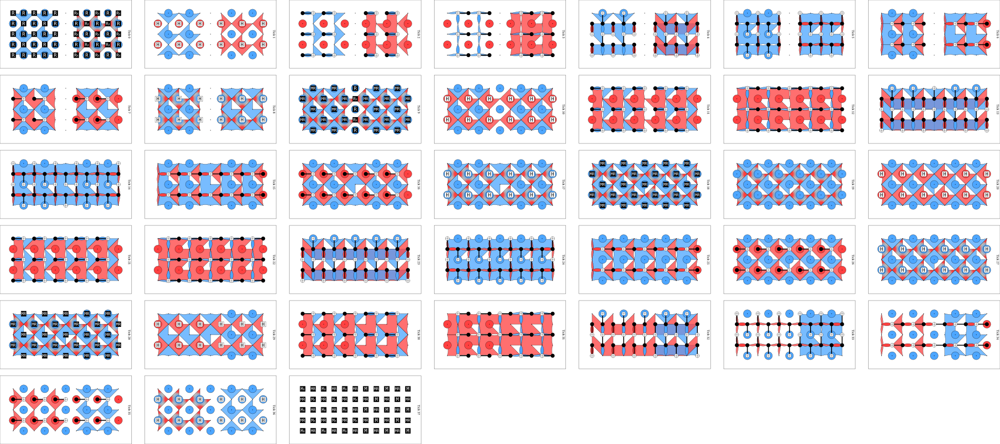

In [20]:
d1 = 3
d2 = 3
rounds = d1
move_state = "Z"
noise_profile = [0.001] * 4
combined_codes = combine_two_patches(d1, d2)
merged_codes, boundary_qubits = merging_two_patches(combined_codes)
circuit_ZX_move = logical_patch_move(d1, d2, rounds, noise_profile, move_state, combined_codes, merged_codes)
circuit_ZX_move.without_noise().diagram("detslice-with-ops-svg")

In [21]:
circuit_ZX_move.diagram("matchgraph-3d")

{"accessors":[{"bufferView":0,"byteOffset":0,"componentType":5126,"count":9,"max":[0,0.400000005960464,0.400000005960464],"min":[0,-0.400000005960464,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":1,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0,0.400000005960464],"min":[-0.400000005960464,0,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":2,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0.400000005960464,0],"min":[-0.400000005960464,-0.400000005960464,0],"name":"circle_loop","type":"VEC3"},{"bufferView":3,"byteOffset":0,"componentType":5126,"count":9,"max":[0,0.400000005960464,0.400000005960464],"min":[0,-0.400000005960464,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":4,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0,0.400000005960464],"min":[-0.400000005960464,0,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":5,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0.400000005960464,0],"min":[-0.400000005960464,-0.400000005960464,0],"name":"circle_loop","type":"VEC3"},{"bufferView":6,"byteOffset":0,"componentType":5126,"count":6060,"max":[39.8058090209961,22,20.164966583252],"min":[-9.80580711364746,-10,-2.77350330352783],"name":"buf_scattered_lines","type":"VEC3"},{"bufferView":7,"byteOffset":0,"componentType":5126,"count":386,"max":[28.0710678100586,20.9442710876465,19.0710678100586],"min":[0.0557279586791992,-8.9442720413208,-1.4721360206604],"name":"buf_red_scattered_lines","type":"VEC3"}],"asset":{"version":"2.0"},"bufferViews":[{"buffer":0,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":1,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":2,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":3,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":4,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":5,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":6,"byteLength":72720,"byteOffset":0,"name":"buf_scattered_lines","target":34962},{"buffer":7,"byteLength":4632,"byteOffset":0,"name":"buf_red_scattered_lines","target":34962}],"buffers":[{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAM3MzD4AAAAAAAAAAMPQkD7D0JA+AAAAAPIwlrLNzMw+AAAAAMPQkL7D0JA+AAAAAM3MzL7yMBazAAAAAMHQkL7E0JC+AAAAAPLkozHNzMy+AAAAAMbQkD6/0JC+AAAAAM3MzD4AAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAAAAAADNzMw+w9CQPgAAAADD0JA+zczMPgAAAADyMJayw9CQPgAAAADD0JC+8jAWswAAAADNzMy+xNCQvgAAAADB0JC+zczMvgAAAADy5KMxv9CQvgAAAADG0JA+AAAAAAAAAADNzMw+"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,zczMPgAAAAAAAAAAw9CQPsPQkD4AAAAA8jCWss3MzD4AAAAAw9CQvsPQkD4AAAAAzczMvvIwFrMAAAAAwdCQvsTQkL4AAAAA8uSjMc3MzL4AAAAAxtCQPr/QkL4AAAAAzczMPgAAAAAAAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAM3MzD4AAAAAAAAAAMPQkD7D0JA+AAAAAPIwlrLNzMw+AAAAAMPQkL7D0JA+AAAAAM3MzL7yMBazAAAAAMHQkL7E0JC+AAAAAPLkozHNzMy+AAAAAMbQkD6/0JC+AAAAAM3MzD4AAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAAAAAADNzMw+w9CQPgAAAADD0JA+zczMPgAAAADyMJayw9CQPgAAAADD0JC+8jAWswAAAADNzMy+xNCQvgAAAADB0JC+zczMvgAAAADy5KMxv9CQvgAAAADG0JA+AAAAAAAAAADNzMw+"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,zczMPgAAAAAAAAAAw9CQPsPQkD4AAAAA8jCWss3MzD4AAAAAw9CQvsPQkD4AAAAAzczMvvIwFrMAAAAAwdCQvsTQkL4AAAAA8uSjMc3MzL4AAAAAxtCQPr/QkL4AAAAAzczMPgAAAAAAAAAA"},{"byteLength":72720,"name":"buf_scattered_lines","uri":"data:application/octet-stream;base64,AADYQQAAQEEAAEBANOoOQjTqgkG8XFE/AADYQQAAQEEAAEBAAACoQQAAQEEAAEBAAADYQQAAQEEAAEBAAACoQQAAQEEAAEBAAADAQQAAEEEAAEBAbi4EQug9QEEAnne8AADYQQAAQEEAAEBAAADYQQAAwEAAAEBAAADYQQAAQEEAAEBAAADYQQAAwEAAAEBAAADwQQAAEEE

In [36]:
tasks = []
d1 = 3
d2 = 3
rounds = d1
move_state = "Z"
noise_profile = [0.001] * 4
combined_codes = combine_two_patches(d1, d2)
merged_codes, boundary_qubits = merging_two_patches(combined_codes)
circuit_ZX_move = logical_patch_move(d1, d2, rounds, noise_profile, move_state, combined_codes, merged_codes)
tasks.append(sinter.Task(circuit=circuit_ZX_move, json_metadata={'d1': d1, 'd2': d2, 'rounds': rounds, 'Experiment': "ZX Move", 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3]}))

collected_stats: List[sinter.TaskStats] = sinter.collect(
    num_workers=6,
    tasks=tasks,
    decoders=['pymatching'],
    max_shots=1000000, # change to large number for full scale experiment
    max_errors=10000, # Whichever first hits the threshold stops the simulation
    print_progress=True,
)

# Convert collected_stats into Dataframe
records = []
for stat in collected_stats:
    d1 = stat.json_metadata['d1']
    d2 = stat.json_metadata['d2']
    rounds = d1
    record = {
        'decoder': stat.decoder,
        'shots': stat.shots,
        'errors': stat.errors,
        'seconds': stat.seconds,
        'rounds': rounds,
        'LER': convert_to_per_round(stat.errors / stat.shots, 1) if stat.shots > 0 else None, # don't average
        'd1': d1, 'd2': d2, 'Experiment': stat.json_metadata['Experiment'],
        'p1': stat.json_metadata['p1'], 'p2': stat.json_metadata['p2'], 'pM': stat.json_metadata['pM'], 'pR': stat.json_metadata['pR']
    }
    records.append(record)
df_sf = pd.DataFrame(records)
df_sf
# df_sf.to_csv("results.csv", index=False) # If you wanna save the experiment data to csv

Starting 6 workers...
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                            
        6 pymatching <1m     997679        9998 d1=3,d2=3,rounds=3,Experiment=ZX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                            
        6 pymatching <1m     668634        9741 d1=3,d2=3,rounds=3,Experiment=ZX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                            
        6 pymatching <1m     276442        9392 d1=3,d2=3,rounds=3,Experiment=ZX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
0 tasks left:



,decoder,shots,errors,seconds,rounds,LER,d1,d2,Experiment,p1,p2,pM,pR
0,pymatching,1000000,813,1.234371,3,0.000813,3,3,ZX Move,0.001,0.001,0.001,0.001


In [37]:
circuit_ZX_move

stim.Circuit('''
    QUBIT_COORDS(0, 0) 0
    QUBIT_COORDS(1, 0) 1
    QUBIT_COORDS(2, 0) 2
    QUBIT_COORDS(3, 0) 3
    QUBIT_COORDS(4, 0) 4
    QUBIT_COORDS(0, 1) 5
    QUBIT_COORDS(1, 1) 6
    QUBIT_COORDS(2, 1) 7
    QUBIT_COORDS(3, 1) 8
    QUBIT_COORDS(4, 1) 9
    QUBIT_COORDS(0, 2) 10
    QUBIT_COORDS(1, 2) 11
    QUBIT_COORDS(2, 2) 12
    QUBIT_COORDS(3, 2) 13
    QUBIT_COORDS(4, 2) 14
    QUBIT_COORDS(0, 3) 15
    QUBIT_COORDS(1, 3) 16
    QUBIT_COORDS(2, 3) 17
    QUBIT_COORDS(3, 3) 18
    QUBIT_COORDS(4, 3) 19
    QUBIT_COORDS(0, 4) 20
    QUBIT_COORDS(1, 4) 21
    QUBIT_COORDS(2, 4) 22
    QUBIT_COORDS(3, 4) 23
    QUBIT_COORDS(4, 4) 24
    QUBIT_COORDS(6, 0) 25
    QUBIT_COORDS(7, 0) 26
    QUBIT_COORDS(8, 0) 27
    QUBIT_COORDS(9, 0) 28
    QUBIT_COORDS(10, 0) 29
    QUBIT_COORDS(6, 1) 30
    QUBIT_COORDS(7, 1) 31
    QUBIT_COORDS(8, 1) 32
    QUBIT_COORDS(9, 1) 33
    QUBIT_COORDS(10, 1) 34
    QUBIT_COORDS(6, 2) 35
    QUBIT_COORDS(7, 2) 36
    QUBIT_COORDS(8, 2) 37
   

The LER is at the same level as the ZZ measurement experiment over two logical $|0\rangle$ state! This shows that it's OK to just decode according to the stabilizers in the end. Let's check the other case that transfer logical $|+\rangle$ state.

In [28]:
d1 = 5
d2 = 3
rounds = d1
move_state = "X"
noise_profile = [0.001] * 4
combined_codes = combine_two_patches(d1, d2)
merged_codes, boundary_qubits = merging_two_patches(combined_codes)
circuit_XX_move = logical_patch_move(d1, d2, rounds, noise_profile, move_state, combined_codes, merged_codes)
circuit_XX_move.without_noise().diagram("detslice-with-ops-svg")

In [34]:
tasks = []
noise_profile = [0.001] * 4
d_list = [3,5,7,9]
d12_list = [(d1, d2) for d1 in d_list for d2 in d_list if d1 >= d2]
for d1, d2 in d12_list:
    rounds = d1
    combined_codes = combine_two_patches(d1, d2)
    merged_codes, boundary_qubits = merging_two_patches(combined_codes)
    circuit_ZX_move = logical_patch_move(d1, d2, rounds, noise_profile, "Z", combined_codes, merged_codes)
    circuit_XX_move = logical_patch_move(d1, d2, rounds, noise_profile, "X", combined_codes, merged_codes)
    tasks.append(sinter.Task(circuit=circuit_ZX_move, json_metadata={'d1': d1, 'd2': d2, 'Experiment': "ZX Move", 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3]}))
    tasks.append(sinter.Task(circuit=circuit_XX_move, json_metadata={'d1': d1, 'd2': d2, 'Experiment': "XX Move", 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3]}))

collected_stats: List[sinter.TaskStats] = sinter.collect(
    num_workers=6,
    tasks=tasks,
    decoders=['pymatching'],
    max_shots=100000000, # change to large number for full scale experiment
    max_errors=50000, # Whichever first hits the threshold stops the simulation
    print_progress=True,
)

# Convert collected_stats into Dataframe
records = []
for stat in collected_stats:
    d1 = stat.json_metadata['d1']
    d2 = stat.json_metadata['d2']
    rounds = d1
    record = {
        'decoder': stat.decoder,
        'shots': stat.shots,
        'errors': stat.errors,
        'seconds': stat.seconds,
        'LER': convert_to_per_round(stat.errors / stat.shots, rounds) if stat.shots > 0 else None,
        'd1': d1, 'd2': d2, 'Experiment': stat.json_metadata['Experiment'],
        'p1': stat.json_metadata['p1'], 'p2': stat.json_metadata['p2'], 'pM': stat.json_metadata['pM'], 'pR': stat.json_metadata['pR']
    }
    records.append(record)
df_sf = pd.DataFrame(records)
df_sf
# df_sf.to_csv("results.csv", index=False) # If you wanna save the experiment data to csv

Starting 6 workers...
20 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                   
        1 pymatching  3m   99996655       49997 d1=3,d2=3,Experiment=ZX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
        1 pymatching   ?  100000000       50000 d1=3,d2=3,Experiment=XX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
        1 pymatching   ?  100000000       50000 d1=5,d2=3,Experiment=ZX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
        1 pymatching   ?  100000000       50000 d1=5,d2=3,Experiment=XX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
        1 pymatching   ?  100000000       50000 d1=5,d2=5,Experiment=ZX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
        1 pymatching   ?  100000000       50000 d1=5,d2=5,Experiment=XX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
        0 pymatching ?·∞  100000000       50000 d1=7,d2=3,Experiment=ZX Move,p1=0.001,p2=0.001,pM=0.001,pR=0.001
        0 pymatching ?·∞  100000000       50000 d1=7,d2=3,E

KeyboardInterrupt: 

In [33]:
df_sf_357 = df_sf
df_sf_357

,decoder,shots,errors,seconds,LER,d1,d2,Experiment,p1,p2,pM,pR
0,pymatching,10000000,8160,15.861104,2.721481e-04,3,3,ZX Move,0.001,0.001,0.001,0.001
1,pymatching,10000000,18639,15.976605,6.220736e-04,3,3,XX Move,0.001,0.001,0.001,0.001
2,pymatching,10000000,19305,38.564477,3.866977e-04,5,3,XX Move,0.001,0.001,0.001,0.001
3,pymatching,10000000,2755,39.119704,5.511215e-05,5,3,ZX Move,0.001,0.001,0.001,0.001
4,pymatching,10000000,2479,88.731648,3.542181e-05,7,3,ZX Move,0.001,0.001,0.001,0.001
5,pymatching,10000000,26833,90.563972,3.842132e-04,7,3,XX Move,0.001,0.001,0.001,0.001
6,pymatching,10000000,409,60.235931,8.180268e-06,5,5,ZX Move,0.001,0.001,0.001,0.001
7,pymatching,10000000,1616,60.244122,3.232418e-05,5,5,XX Move,0.001,0.001,0.001,0.001
8,pymatching,10000000,116,124.337060,1.657159e-06,7,5,ZX Move,0.001,0.001,0.001,0.001
9,pymatching,10000000,1268,123.441893,1.811625e-05,7,5,XX Move,0.001,0.001,0.001,0.001


In [32]:
d_list = [3,5,7,9]
d12_list = [(d1, d2) for d1 in d_list for d2 in d_list if d1 >= d2]
d12_list

[(3, 3),
 (5, 3),
 (5, 5),
 (7, 3),
 (7, 5),
 (7, 7),
 (9, 3),
 (9, 5),
 (9, 7),
 (9, 9)]

This logical move operation involves the "joint decoding" of two logical measurement operations, which goes one step further than the previous ZZ measurement experiment. The construction of logical observables vary from different input state ($|0\rangle$ or $|+\rangle$, the target patch is always initialized in $|+\rangle$ if we perform ZZ measurement first).  

(1) The LER sees the expected suppression behavior both in Z move and X move. Let's take a closer look.  
(1.1) Fix d2. It seems that there might be an error floor when fixing the smaller distance d2. See (3,3), (5,3), (7,3) Z move, the error suppression seems to slow down. X move has the same behavior of error floor, except that it's around one magnitude higher (the dicrepancy seems to grow larger as the distance increases), and may hit the error floor earlier (see (5,3) (7,3) X move, about the same). Look at (5,5), (7,5) Z and X move, the improvement is not that much, comparing from (3,3) (5,5) (7,7) Z and X move. This means the logical operation between biased surface code will finally be bottlenecked by the smaller distance code. The biased (d1,d2) logical Z move gives LER between (d1,d1) and (d2,d2), while the biased (d1,d2) logical X move has LER higher than the d2-distance memory experiment, although it decreses as d1 increases.**I still need to figure out why ZX move and XX move has so different behavior. Check if my logical observable construction is correct.**  
(1.2) Fix d1. When d2 increases to d1, the LER seems to have an exponential suppression. See (7,3), (7,5), (7,7) both Z and X move, they seem to have the same suppression speed, except that there seem to be a constant factor between Z move and X move.  
(1.3) Increase d in (d,d). Seem to have the desired exponential suppression.
 
(2) Compared to ZZ measurement. Z move has similar LER as ZZ measurement, while X move has higher LER.

(3) Compared to memory experiment.  
(3.1) Fix d2. (3,3) (5,3) (7,3) Z move can achieve lower LER than d = 3 memory experiment, meaning it goes beyond the QEC capability of the target code so that it has to be enlarged to maintain the same level of LER. However, (3,3) (5,3) (7,3) X move shows an error floor that's higher than the distance-3 single patch memory X experiment (see also (5,5) (7,5) X move).  
(3.2) Fix d1. (7,3) (7,5) (7,7) Z move can go below the d = 7 Z memory experiment, probably because (7,7) case has performance enhanced by the merged patch. (7,3) (7,5) (7,7) X move also see (exponential) suppression, but (7,7) X move has higher LER than the single patch x memory experiment.

In [114]:
# Sampling
num_shots = 1000000
rounds = d
samples_CrossLS = circuit_XX_move.compile_detector_sampler().sample(num_shots, append_observables=True)
detection_events = samples_CrossLS[:, :-1]
observable_flips = samples_CrossLS[:, -1:]

# LER without decoding
LER_no_decode = np.sum(samples_CrossLS[:, -1])/num_shots
print("LER without decoding: ", convert_to_per_round(LER_no_decode, rounds))

# Decoder setup
detector_error_model = circuit_XX_move.detector_error_model(decompose_errors=True)
matcher = pymatching.Matching.from_detector_error_model(detector_error_model)
predictions = matcher.decode_batch(detection_events)

# Count ZZ logical errors
logical_error = np.sum(np.any(predictions != observable_flips, axis=1))
LER_total = logical_error / num_shots
ler_per_round = convert_to_per_round(LER_total, rounds)
print("LER of CrossLS after decoding: ", ler_per_round)

# # Store results
# results.append({"distance": d, "noise": noise, "rounds": rounds, "LER(QEC)": ler_per_round, 
#     "LER(without QEC)": ler_noQEC, "Experiment": "XX Measurement"})

LER without decoding:  0.014372866394788686
LER of CrossLS after decoding:  0.0006020579900063439


### Code Enlarging

In [66]:
# Code Enlarging
def code_enlarge(d: int, rounds: int, initial_state: str, noise_profile: List[float]) -> stim.Circuit:
    '''d: distance of the surface code
    rounds: number of SM rounds after XX measurement
    noise_profile: [p1, p2, p_M, p_R]
    Only enlarge in one direction by distance 1'''

    p1, p2, p_M, p_R = noise_profile

    full_circuit = stim.Circuit()
    sf_code = psc.PlanarSurfaceCode(d)

    # Update logical Z of code 1 from left side to right side for merging
    sf_code.logical_Z[0] = psc.PlanarSurfaceCode.shift_coords(sf_code.logical_Z[0], 2 * (d - 1), 0)

    # Construct the ancilla system for lattice surgery
    enlarge_data = [(2*d-1, 2*y+1) for y in range(d-1)] + [(2*d,2*y) for y in range(d)]
    enlarge_ancilla_z = [(2*d-1, 2*y) for y in range(d)]
    enlarge_ancilla_x = [(2*d,2*y+1) for y in range(d-1)]
    enlarge_ancilla = enlarge_ancilla_z + enlarge_ancilla_x
    coord_to_index_enlarge = {coord: i for i, coord in enumerate(enlarge_data + enlarge_ancilla)}

    # Combine surface code and the enlarged part
    # qubit_coords = sf_code.qubit_coords + data_coords_PQRM
    coord_to_index = {}
    coord_to_index.update(sf_code.coord_to_index)
    offset1 = max(coord_to_index.values()) + 1
    coord_to_index_shifted = {coord: i + offset1 for coord, i in coord_to_index_enlarge.items()}
    coord_to_index.update(coord_to_index_shifted)

    # Incorporate the enlarged system into the surface code, build unified SM circuits
    sf_code_ex = copy.deepcopy(sf_code)
    sf_code_ex.data_coords = sf_code.data_coords + enlarge_data
    sf_code_ex.ancilla_coords_z += enlarge_ancilla_z
    sf_code_ex.ancilla_coords_x += enlarge_ancilla_x
    sf_code_ex.ancilla_coords =  sf_code.ancilla_coords + enlarge_ancilla
    sf_code_ex.coord_to_index = coord_to_index
    # Update stabilizers
    stabilizers = sf_code.stabilizers

    # Update the boundary X-stabilizers from weight-3 to weight-4
    for stab in stabilizers:
        anc = stab['ancilla']
        if anc[0] == 2*d-2:
            stab['data'] = [(anc[0] -1, anc[1]), (anc[0] +1, anc[1]),(anc[0], anc[1]-1), (anc[0], anc[1]+1)]

    # Add new X, Z-stabilizers
    for syn in enlarge_ancilla:
        if syn[0] == 2*d -1: # Z-stabilizers
            if syn[1] == 0: # top weight-3 Z-stabilizer
                stab = {'type': 'Z', 'ancilla': syn, 'data': [(syn[0] - 1, syn[1]), (syn[0] + 1, syn[1]), (syn[0], syn[1] + 1)]}
            elif syn[1] < 2*d - 2: # middle weight-4 stabilizers
                stab = {'type': 'Z', 'ancilla': syn, 'data': [(syn[0]-1, syn[1]), (syn[0]+1, syn[1]), (syn[0], syn[1]-1), (syn[0], syn[1]+1)]}
            else: # bottom weight-3 Z-stabilizer
                stab = {'type': 'Z', 'ancilla': syn, 'data': [(syn[0] - 1, syn[1]), (syn[0] + 1, syn[1]), (syn[0], syn[1] - 1)]}
        if syn[0] == 2*d: # weight-3 X-stabilizers
                stab = {'type': 'X', 'ancilla': syn, 'data': [(syn[0] - 1, syn[1]), (syn[0], syn[1] - 1), (syn[0], syn[1] + 1)]}
        stabilizers.append(stab)
    sf_code_ex.stabilizers = stabilizers
    
    # (1) Construct one perfect surface codes using one round of SM without noise
    # Add QUBIT_COORDS annotations
    for (x, y), index in sf_code_ex.coord_to_index.items():
        full_circuit.append('QUBIT_COORDS', [index], [x, y])

    # Initialization of qubits in the original patch (no boundary qubits yet)
    data_indices = [sf_code.coord_to_index[c] for c in sf_code.data_coords]
    ancilla_indices = [sf_code.coord_to_index[c] for c in sf_code.ancilla_coords]
    if initial_state == "Z":
        full_circuit.append_operation("R", data_indices)
    if initial_state == "X":
        full_circuit.append_operation("RX", data_indices)
    full_circuit.append_operation("R", ancilla_indices)
    full_circuit.append("TICK")

    # One round of SM without noise, gives a perfect surface codes
    # At this point we have two surface codes with +1 Z-stabilziers and random value X-stabilizers
    full_circuit += sf_code.build_standard_sm_round(noise_profile)
    # Detectors
    for k, ancilla in enumerate(reversed(sf_code.ancilla_coords)):
        if initial_state == "Z":
            if ancilla in sf_code.ancilla_coords_z:
                full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1)], list(ancilla) + [0])
        if initial_state == "X":
            if ancilla in sf_code.ancilla_coords_x:
                full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1)], list(ancilla) + [0])

    full_circuit = full_circuit.without_noise()

    # (2) Enlarge on the right
    # Initialize the boundary qubits
    enlarge_data_indices_x = [coord_to_index[c] for c in enlarge_data if c != (2*d,0)]
    enlarge_data_indices_z = [coord_to_index[(2*d,0)]]
    enlarge_ancilla_indices = [coord_to_index[c] for c in enlarge_ancilla]
    full_circuit.append_operation("X_ERROR", enlarge_ancilla_indices, p_R)
    full_circuit.append_operation("R", enlarge_ancilla_indices)
    full_circuit.append_operation("Z_ERROR", enlarge_data_indices_x, p_R)
    full_circuit.append_operation("RX", enlarge_data_indices_x)
    full_circuit.append_operation("X_ERROR", enlarge_data_indices_z, p_R)
    full_circuit.append_operation("R", enlarge_data_indices_z)
    full_circuit.append("TICK")

    # Insert one round noisy SM for the extended surface code, fix the guage
    full_circuit += sf_code_ex.build_standard_sm_round(noise_profile)
    # Detectors
    for k, ancilla in enumerate(reversed(sf_code_ex.ancilla_coords)):
        ancilla_index = sf_code_ex.coord_to_index[ancilla]
        prev = -k - 1 - len(sf_code.ancilla_coords) # not the extended ancilla coords, but the original ones!
        if ancilla[0] < 2*d-1:
            full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1), stim.target_rec(prev)], list(ancilla) + [0])
        if ancilla[0] == 2*d and ancilla[1] > 2:
            full_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1)], list(ancilla) + [0])

    # Later rounds, repeated meausrements, all stabilizers gives detectors
    repeat_circuit = stim.Circuit()
    repeat_circuit.append("TICK")
    repeat_circuit += sf_code_ex.build_standard_sm_round(noise_profile)
    repeat_circuit.append_operation("SHIFT_COORDS", [], [0,0,1])

    for k, ancilla in enumerate(reversed(sf_code_ex.ancilla_coords)):
        prev = -k - 1 - len(sf_code_ex.ancilla_coords) # now it's the extended ancilla coords
        repeat_circuit.append_operation("DETECTOR", [stim.target_rec(-k - 1), stim.target_rec(prev)], list(ancilla) + [0])

    full_circuit += repeat_circuit * (rounds-1)

    # Final measurement
    # Measure the first patch in Z/X basis depending on the initial state
    data_final = [coord for coord in sf_code_ex.data_coords]
    data_indices_final = [sf_code_ex.coord_to_index[coord] for coord in data_final]
    if initial_state == "Z":
        full_circuit.append_operation("X_ERROR", data_indices_final, p_M)
        full_circuit.append_operation("M", data_indices_final)
    if initial_state == "X":
        full_circuit.append_operation("Z_ERROR", data_indices_final, p_M)
        full_circuit.append_operation("MX", data_indices_final)

    # Final Detectors: Z/X stabilizers on the enlarged patch, depending on the measurements
    for stab in sf_code_ex.stabilizers:
        if stab['type'] == initial_state:
            try:
                ancilla_index = sf_code_ex.ancilla_coords[::-1].index(stab['ancilla'])
                anc_rec = stim.target_rec(-ancilla_index - 1 - len(data_indices_final))
                data_rec_targets = [stim.target_rec(-data_final[::-1].index(q) - 1) for q in stab['data']]
                full_circuit.append_operation("DETECTOR", [anc_rec] + data_rec_targets, list(stab['ancilla']) + [1])
            except ValueError:
                continue
    
    # Logical observable
    if initial_state == "Z":
        # Logical observale: Z gauge operators + boundary data qubits
        log_ob_gauge = [(2*d-1,2*y) for y in range(d)]
        log_ob_gauge_indices = [sf_code_ex.ancilla_coords[::-1].index(anc) for anc in log_ob_gauge]
        log_ob_gauge_records = [stim.target_rec(-k-1-len(sf_code_ex.data_coords)) for k in log_ob_gauge_indices]
        log_ob_data = [(2*d,2*y) for y in range(d)]
        log_ob_data_indices = [data_final[::-1].index(data) for data in log_ob_data]
        log_ob_data_records = [stim.target_rec(-k-1) for k in log_ob_data_indices]
        full_circuit.append_operation("OBSERVABLE_INCLUDE", log_ob_gauge_records + log_ob_data_records, 0)

    if initial_state == "X":
        # Logical observale: one X gauge (top right) + top logical X op
        log_ob_gauge = [(2*d,1)]
        log_ob_gauge_indices = [sf_code_ex.ancilla_coords[::-1].index(anc) for anc in log_ob_gauge]
        log_ob_gauge_records = [stim.target_rec(-k-1-len(sf_code_ex.data_coords)) for k in log_ob_gauge_indices]
        log_ob_x = [(2*x,0) for x in range(d+1)]
        log_ob_data_indices = [(data_final)[::-1].index(data) for data in log_ob_x]
        log_ob_data_records = [stim.target_rec(-k-1) for k in log_ob_data_indices]
        full_circuit.append_operation("OBSERVABLE_INCLUDE", log_ob_gauge_records+log_ob_data_records, 0)

    return full_circuit

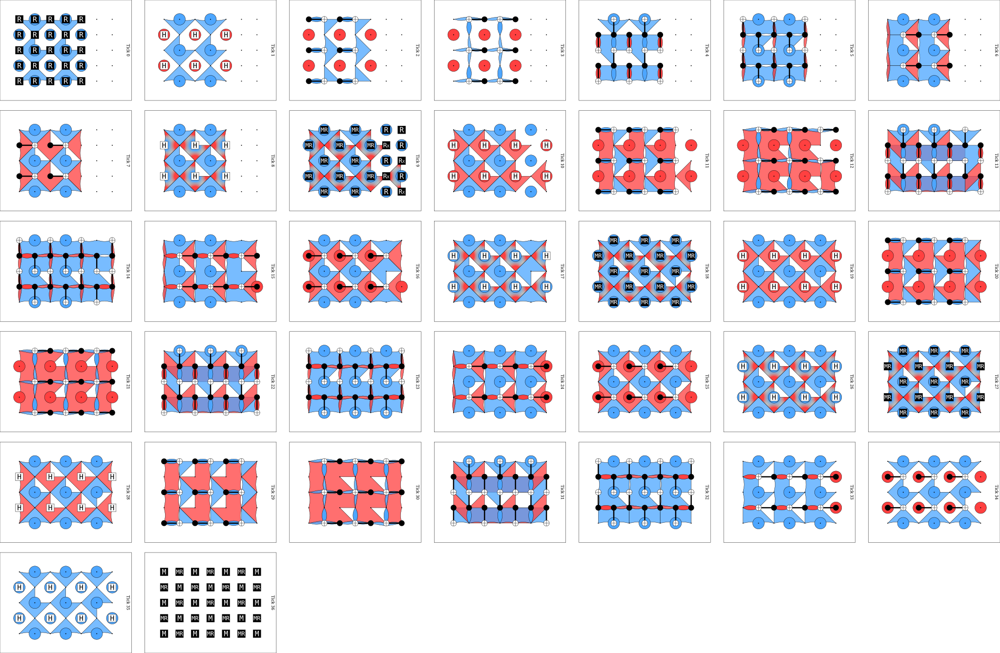

In [67]:
d_surf = 3
rounds = d_surf
initial_state = "Z"
noise = 0.001
noise_profile = [noise] * 4
circuit_enlarge = code_enlarge(d_surf, rounds, initial_state, noise_profile)
circuit_enlarge.without_noise().diagram("detslice-with-ops-svg")

In [48]:
tasks = []
noise = 0.001
noise_profile = [noise] * 4
d_list = [3]
for d in d_list:
    for initial_state in ["Z"]:
        rounds = d
        combined_codes = combine_two_patches(d, d)
        merged_codes, boundary_qubits = merging_two_patches(combined_codes)
        circuit_enlarge = code_enlarge(d, rounds, initial_state, noise_profile)
        tasks.append(sinter.Task(circuit=circuit_enlarge, json_metadata={'d1': d, 'd2': d, 'rounds': rounds, 'Experiment': initial_state + " enlarge", 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3]}))

collected_stats: List[sinter.TaskStats] = sinter.collect(
    num_workers=6,
    tasks=tasks,
    decoders=['pymatching'],
    max_shots=1000000, # change to large number for full scale experiment
    max_errors=10000, # Whichever first hits the threshold stops the simulation
    print_progress=True,
)

# Convert collected_stats into Dataframe
records = []
for stat in collected_stats:
    d1 = stat.json_metadata['d1']
    d2 = stat.json_metadata['d2']
    rounds = stat.json_metadata['rounds']
    record = {
        'decoder': stat.decoder,
        'shots': stat.shots,
        'errors': stat.errors,
        'seconds': stat.seconds,
        'rounds': rounds,
        'LER': convert_to_per_round(stat.errors / stat.shots, 1) if stat.shots > 0 else None, # don't average
        'd1': d1, 'd2': d2, 'Experiment': stat.json_metadata['Experiment'],
        'p1': stat.json_metadata['p1'], 'p2': stat.json_metadata['p2'], 'pM': stat.json_metadata['pM'], 'pR': stat.json_metadata['pR']
    }
    records.append(record)
df_sf = pd.DataFrame(records)
df_sf
# df_sf.to_csv("results.csv", index=False) # If you wanna save the experiment data to csv

Starting 6 workers...
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                              
        6 pymatching <1m     961839       10000 d1=3,d2=3,rounds=3,Experiment=Z enlarge,p1=0.001,p2=0.001,pM=0.001,pR=0.001
1 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                              
        6 pymatching <1m          8       10000 d1=3,d2=3,rounds=3,Experiment=Z enlarge,p1=0.001,p2=0.001,pM=0.001,pR=0.001
0 tasks left:



,decoder,shots,errors,seconds,rounds,LER,d1,d2,Experiment,p1,p2,pM,pR
0,pymatching,1000000,0,0.132683,3,0.0,3,3,Z enlarge,0.001,0.001,0.001,0.001


In [68]:
circuit_enlarge.diagram("matchgraph-3d")

{"accessors":[{"bufferView":0,"byteOffset":0,"componentType":5126,"count":9,"max":[0,0.400000005960464,0.400000005960464],"min":[0,-0.400000005960464,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":1,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0,0.400000005960464],"min":[-0.400000005960464,0,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":2,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0.400000005960464,0],"min":[-0.400000005960464,-0.400000005960464,0],"name":"circle_loop","type":"VEC3"},{"bufferView":3,"byteOffset":0,"componentType":5126,"count":9,"max":[0,0.400000005960464,0.400000005960464],"min":[0,-0.400000005960464,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":4,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0,0.400000005960464],"min":[-0.400000005960464,0,-0.400000005960464],"name":"circle_loop","type":"VEC3"},{"bufferView":5,"byteOffset":0,"componentType":5126,"count":9,"max":[0.400000005960464,0.400000005960464,0],"min":[-0.400000005960464,-0.400000005960464,0],"name":"circle_loop","type":"VEC3"},{"bufferView":6,"byteOffset":0,"componentType":5126,"count":3768,"max":[27.3704261779785,18.9631061553955,15],"min":[-9.3704252243042,-6.96310567855835,-7.27606868743896],"name":"buf_scattered_lines","type":"VEC3"},{"bufferView":7,"byteOffset":0,"componentType":5126,"count":322,"max":[23,20,15],"min":[9,-8,-10],"name":"buf_red_scattered_lines","type":"VEC3"}],"asset":{"version":"2.0"},"bufferViews":[{"buffer":0,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":1,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":2,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":3,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":4,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":5,"byteLength":108,"byteOffset":0,"name":"circle_loop","target":34962},{"buffer":6,"byteLength":45216,"byteOffset":0,"name":"buf_scattered_lines","target":34962},{"buffer":7,"byteLength":3864,"byteOffset":0,"name":"buf_red_scattered_lines","target":34962}],"buffers":[{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAM3MzD4AAAAAAAAAAMPQkD7D0JA+AAAAAPIwlrLNzMw+AAAAAMPQkL7D0JA+AAAAAM3MzL7yMBazAAAAAMHQkL7E0JC+AAAAAPLkozHNzMy+AAAAAMbQkD6/0JC+AAAAAM3MzD4AAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAAAAAADNzMw+w9CQPgAAAADD0JA+zczMPgAAAADyMJayw9CQPgAAAADD0JC+8jAWswAAAADNzMy+xNCQvgAAAADB0JC+zczMvgAAAADy5KMxv9CQvgAAAADG0JA+AAAAAAAAAADNzMw+"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,zczMPgAAAAAAAAAAw9CQPsPQkD4AAAAA8jCWss3MzD4AAAAAw9CQvsPQkD4AAAAAzczMvvIwFrMAAAAAwdCQvsTQkL4AAAAA8uSjMc3MzL4AAAAAxtCQPr/QkL4AAAAAzczMPgAAAAAAAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAM3MzD4AAAAAAAAAAMPQkD7D0JA+AAAAAPIwlrLNzMw+AAAAAMPQkL7D0JA+AAAAAM3MzL7yMBazAAAAAMHQkL7E0JC+AAAAAPLkozHNzMy+AAAAAMbQkD6/0JC+AAAAAM3MzD4AAAAA"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,AAAAAAAAAADNzMw+w9CQPgAAAADD0JA+zczMPgAAAADyMJayw9CQPgAAAADD0JC+8jAWswAAAADNzMy+xNCQvgAAAADB0JC+zczMvgAAAADy5KMxv9CQvgAAAADG0JA+AAAAAAAAAADNzMw+"},{"byteLength":108,"name":"circle_loop","uri":"data:application/octet-stream;base64,zczMPgAAAAAAAAAAw9CQPsPQkD4AAAAA8jCWss3MzD4AAAAAw9CQvsPQkD4AAAAAzczMvvIwFrMAAAAAwdCQvsTQkL4AAAAA8uSjMc3MzL4AAAAAxtCQPr/QkL4AAAAAzczMPgAAAAAAAAAA"},{"byteLength":45216,"name":"buf_scattered_lines","uri":"data:application/octet-stream;base64,AACQQQAAEEEAAAAASZLUQdy2PUGSJInAAACQQQAAEEEAAAAAAABAQQAAEEEAAAAAAACQQQAAEEEAAAAAAABAQQAAEEEAAAAAAABAQQAAQEAAAAAAQs6GQSTk7L+O1ejAAACQQQAAEEEAAAAAAABAQQAAEEEAAAAAAABwQQAAQEEAAEBAcbSvQXG0l0E9LqE/AACQQQAAEEEAAAAAAABAQQAAEEEAAAAAAABwQQAAQEEAAEBAAABwQQAAwEAAAEBAAACQQQAAEEEAAAAAAAB

In [108]:
tasks = []
noise = 0.001
noise_profile_list = np.array(list(product([0, 1], repeat=4))) * [noise, noise, 5*noise, noise]
d_list = [5]
for d in d_list:
    for initial_state in ["Z"]:
        for noise_profile in noise_profile_list:
            for rounds in [d, (d-1)//2]:
                combined_codes = combine_two_patches(d, d)
                merged_codes, boundary_qubits = merging_two_patches(combined_codes)
                circuit_enlarge = code_enlarge(d, rounds, initial_state, noise_profile)
                tasks.append(sinter.Task(circuit=circuit_enlarge, json_metadata={'d1': d, 'd2': d, 'rounds': rounds, 'Experiment': initial_state + " enlarge", 'p1': noise_profile[0], 'p2': noise_profile[1], 'pM': noise_profile[2], 'pR': noise_profile[3]}))

collected_stats: List[sinter.TaskStats] = sinter.collect(
    num_workers=6,
    tasks=tasks,
    decoders=['pymatching'],
    max_shots=10000000, # change to large number for full scale experiment
    max_errors=10000, # Whichever first hits the threshold stops the simulation
    print_progress=True,
)

# Convert collected_stats into Dataframe
records = []
for stat in collected_stats:
    d1 = stat.json_metadata['d1']
    d2 = stat.json_metadata['d2']
    rounds = stat.json_metadata['rounds']
    record = {
        'decoder': stat.decoder,
        'shots': stat.shots,
        'errors': stat.errors,
        'seconds': stat.seconds,
        'rounds': rounds,
        'LER': convert_to_per_round(stat.errors / stat.shots, 1) if stat.shots > 0 else None, # don't average
        'd1': d1, 'd2': d2, 'Experiment': stat.json_metadata['Experiment'],
        'p1': stat.json_metadata['p1'], 'p2': stat.json_metadata['p2'], 'pM': stat.json_metadata['pM'], 'pR': stat.json_metadata['pR']
    }
    records.append(record)
df_sf = pd.DataFrame(records)
df_sf
# df_sf.to_csv("results.csv", index=False) # If you wanna save the experiment data to csv

Starting 6 workers...
32 tasks left:
  workers    decoder eta shots_left errors_left json_metadata                                                              
        1 pymatching <1m    9995631       10000 d1=5,d2=5,rounds=5,Experiment=Z enlarge,p1=0.0,p2=0.0,pM=0.0,pR=0.0        
        1 pymatching   ?   10000000       10000 d1=5,d2=5,rounds=2,Experiment=Z enlarge,p1=0.0,p2=0.0,pM=0.0,pR=0.0        
        1 pymatching   ?   10000000       10000 d1=5,d2=5,rounds=5,Experiment=Z enlarge,p1=0.0,p2=0.0,pM=0.0,pR=0.001      
        1 pymatching   ?   10000000       10000 d1=5,d2=5,rounds=2,Experiment=Z enlarge,p1=0.0,p2=0.0,pM=0.0,pR=0.001      
        1 pymatching   ?   10000000       10000 d1=5,d2=5,rounds=5,Experiment=Z enlarge,p1=0.0,p2=0.0,pM=0.005,pR=0.0      
        1 pymatching   ?   10000000       10000 d1=5,d2=5,rounds=2,Experiment=Z enlarge,p1=0.0,p2=0.0,pM=0.005,pR=0.0      
        0 pymatching ?·∞   10000000       10000 d1=5,d2=5,rounds=5,Experiment=Z enlarge,p1=0.0,

,decoder,shots,errors,seconds,rounds,LER,d1,d2,Experiment,p1,p2,pM,pR
0,pymatching,10000000,0,14.753671,5,0.000000e+00,5,5,Z enlarge,0.000,0.000,0.000,0.000
1,pymatching,10000000,0,9.202188,2,0.000000e+00,5,5,Z enlarge,0.000,0.000,0.000,0.001
2,pymatching,10000000,78,12.910724,2,7.800000e-06,5,5,Z enlarge,0.000,0.000,0.005,0.000
3,pymatching,10000000,0,15.975691,5,0.000000e+00,5,5,Z enlarge,0.000,0.000,0.000,0.001
4,pymatching,10000000,73,23.494771,5,7.300000e-06,5,5,Z enlarge,0.000,0.000,0.005,0.000
5,pymatching,10000000,0,8.602690,2,0.000000e+00,5,5,Z enlarge,0.000,0.000,0.000,0.000
6,pymatching,10000000,79,29.080896,5,7.900000e-06,5,5,Z enlarge,0.000,0.000,0.005,0.001
7,pymatching,10000000,75,17.389973,2,7.500000e-06,5,5,Z enlarge,0.000,0.000,0.005,0.001
8,pymatching,10000000,48,28.299300,5,4.800000e-06,5,5,Z enlarge,0.000,0.001,0.000,0.000
9,pymatching,10000000,18,15.841794,2,1.800000e-06,5,5,Z enlarge,0.000,0.001,0.000,0.000


In [112]:
df_sf[df_sf.rounds == 5].sort_values('LER')

,decoder,shots,errors,seconds,rounds,LER,d1,d2,Experiment,p1,p2,pM,pR
0,pymatching,10000000,0,14.753671,5,0.000000e+00,5,5,Z enlarge,0.000,0.000,0.000,0.000
3,pymatching,10000000,0,15.975691,5,0.000000e+00,5,5,Z enlarge,0.000,0.000,0.000,0.001
18,pymatching,10000000,2,27.916517,5,2.000000e-07,5,5,Z enlarge,0.001,0.000,0.000,0.001
16,pymatching,10000000,3,25.379705,5,3.000000e-07,5,5,Z enlarge,0.001,0.000,0.000,0.000
8,pymatching,10000000,48,28.299300,5,4.800000e-06,5,5,Z enlarge,0.000,0.001,0.000,0.000
10,pymatching,10000000,54,32.674886,5,5.400000e-06,5,5,Z enlarge,0.000,0.001,0.000,0.001
4,pymatching,10000000,73,23.494771,5,7.300000e-06,5,5,Z enlarge,0.000,0.000,0.005,0.000
6,pymatching,10000000,79,29.080896,5,7.900000e-06,5,5,Z enlarge,0.000,0.000,0.005,0.001
20,pymatching,10000000,81,36.192776,5,8.100000e-06,5,5,Z enlarge,0.001,0.000,0.005,0.000
22,pymatching,10000000,96,39.181291,5,9.600000e-06,5,5,Z enlarge,0.001,0.000,0.005,0.001


We found a fidelity gap between enlarging |+> state and |0> state. The gap can be as large as one order of magnitude. This implies that the accuracy of enlarging depends on the underlying state and the enlarging boundary. It may be better to use ZZ measurement for enlarging a |0> state and use XX measurement for enlarging a |+> state. We can verify this.  

Another observation is: The effect of measurement error and reset error is largely mitigated by the repeated measurement. Compare the effect of p_M and p_R in the case rounds = d and (d-1)//2. This means the error propagation after gate operations leading into uncorrectable high-weight errors is probably the main reason for decoding failure. Ideally, the decoder captures and correct all the correctable errors (wt <= (d-1) // 2), so the residual error rate is of the order $O(p^{(d+1)/2})$, and that's why the LER sees exponential suppression as the code distance scales. In practice, due to the harmful error propagation in circuit design for syndrome measurements or logical operations and the

